In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sentence_transformers import SentenceTransformer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split

import boto3

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


# public data: https://www.kaggle.com/datasets/maharshipandya/-spotify-tracks-dataset
# personal data: spotify API

In [2]:
def read_full_table(table_name):
    session = boto3.Session(profile_name="default")
    dynamodb = session.resource("dynamodb", region_name="eu-west-1")
    table = dynamodb.Table(table_name)
    response = table.scan()
    data = response["Items"]

    # Handle pagination
    while "LastEvaluatedKey" in response:
        response = table.scan(ExclusiveStartKey=response["LastEvaluatedKey"])
        data.extend(response["Items"])
        
    return pd.DataFrame(data)

In [3]:
numerical_cols = ["num_sections", "danceability", "sections_avg_duration", "instrumentalness", "liveness", "loudness",
                  "duration", "speechiness", "valence", "dynamics_changes", "tempo_changes", "acousticness",
                  "time_signature_changes", "popularity", "mode_changes", "energy", "key_changes", "tempo"]
numerical_cols_public = ["danceability", "instrumentalness", "liveness", "loudness", "duration", "speechiness", 
                         "valence", "acousticness", "popularity", "energy", "tempo"]

non_standarized_cols = ["num_sections", "sections_avg_duration", "loudness", "duration", "dynamics_changes", 
                         "tempo_changes", "time_signature_changes", "popularity", "mode_changes", "key_changes", "tempo"]
categorical_cols = ["key", "mode"]

notes = ("C", "C#", "D", "Eb", "E", "F", "F#", "G", "Ab", "A", "Bb", "B")
key_mapping = {i:note for i, note in enumerate(notes)}
key_mapping[-1] = "NoKey"

mode_mapping = {0: "Minor", 1: "Major"}

random_state = 602452

In [165]:
top_artists_raw = read_full_table("top_artists")
recently_played_raw = read_full_table("recently_played")
track_info_raw = read_full_table("track_info")
public_data_raw = pd.read_csv(r"C:\Users\jcf\Desktop\codigo\Portfolio\Spotify Analysis\public_music_data.csv")

In [296]:
top_artists = top_artists_raw.copy()
recently_played = recently_played_raw.copy()
track_info = track_info_raw.copy()
public_data = public_data_raw.copy()

In [ ]:
track_info["key"] = track_info["key"].map(key_mapping)
track_info["mode"] = track_info["mode"].map(mode_mapping)

public_data["key"] = public_data["key"].map(key_mapping)
public_data["mode"] = public_data["mode"].map(mode_mapping)

In [330]:
for col in numerical_cols:
    track_info[col] = pd.to_numeric(track_info[col])
    
for col in track_info.columns:
    if "changes" in col:
        track_info[col] = track_info[col] / track_info["duration"]

track_info["case"] = "user"

public_data["duration"] = public_data["duration_ms"] / 1000
public_data["case"] = "public"

genre_info = track_info.explode("genres")
genre_info = genre_info.loc[:, ["genres", "track_id", "artist"]]
genre_info = genre_info.groupby(["genres"]).nunique().reset_index()
genre_info["track_perc"] = 100 * genre_info["track_id"] / genre_info["track_id"].sum()
genre_info["artist_perc"] = 100 * genre_info["artist"] / genre_info["artist"].sum()

genre_info_public = public_data.loc[:, ["track_genre", "track_id", "artists"]]
genre_info_public = genre_info_public.groupby(["track_genre"]).nunique().reset_index()
genre_info_public["track_perc"] = 100 * genre_info_public["track_id"] / genre_info_public["track_id"].sum()
genre_info_public["artist_perc"] = 100 * genre_info_public["artists"] / genre_info_public["artists"].sum()

In [116]:
# genre_info = track_info.genres


In [201]:
# public_data

# do analysis (numerical and plots)
'track_name', 'album', 'artist', 'track_id', 'raw_sections'

'num_sections', 'danceability',  'sections_avg_duration',
'instrumentalness', 'liveness', 'loudness', 'duration', 'speechiness',
'valence', 'dynamics_changes', 'mode', 'tempo_changes',
'acousticness', 'time_signature_changes',
'popularity', 'mode_changes', 'energy', 'key_changes', 'key',
'tempo', 'explicit'

# show top artists and recenelty played in table

# plots: 
    X - histograma features canciones -> here/tableau
    X - histograma generos -> here
    X - correlaciones entre features -> here
    X - clustering usuario (y public?) -> here
    - predictor de genero con features (train con public, test con usuario. comparar con clusters de antes)
    X - comparativas usuario y public -> here
    
    -try to replicate them in tableau


# model:
# try to group more the genres (manually? semantic comparison?) -> to reduce the total 
# clustering kmeans usuario (standarize first)
# modelo predictor genero (?)

In [451]:
for row in track_info.genres.sample(5):
    print(row)

['acoustic rock']
['alternative rock', 'modern rock', 'permanent wave', 'rock']
['experimental indie rock', 'modern alternative rock']
['alternative metal', 'alternative rock', 'modern rock', 'permanent wave', 'post-grunge', 'rock']
['alternative metal', 'alternative rock', 'funk metal', 'funk rock', 'grunge', 'nu metal']


total_elements=240, top_elements=83


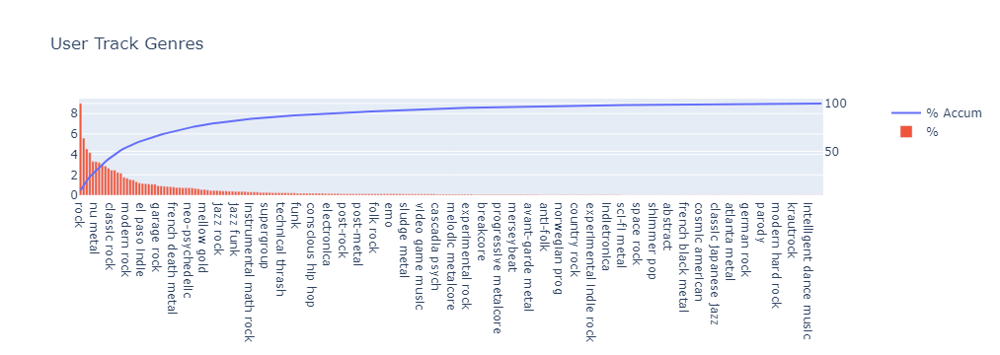

In [252]:
for element in ("track", "artist"):
    genre_info_plot = genre_info.sort_values(by=f"{element}_perc", ascending=False)
    genre_info_plot[f"{element}_perc_accum"] = genre_info_plot[f"{element}_perc"].cumsum()
    
    total_elements = genre_info_plot["genres"].nunique()
    top_elements = genre_info_plot.loc[genre_info_plot[f"{element}_perc_accum"] <= 90, "genres"].nunique()
    
    print(f"{total_elements=}, {top_elements=}")

    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(
        go.Scatter(x=genre_info_plot["genres"], y=genre_info_plot[f"{element}_perc_accum"], name="% Accum"),
        secondary_y=True,
    )
    fig.add_trace(
        go.Bar(x=genre_info_plot["genres"], y=genre_info_plot[f"{element}_perc"], name="%"),
        secondary_y=False,
    )
    fig.update_layout(
        title_text=f"User {element.capitalize()} Genres"
    )

    fig.show()

In [233]:
# px.bar(genre_info.sort_values(by="artist_perc", ascending=False), x="genres", y="artist_perc", title="User Artist Genres")

In [234]:
# px.bar(genre_info_public.sort_values(by="track_id", ascending=False), x="track_genre", y="track_id")

total_elements=114, top_elements=102


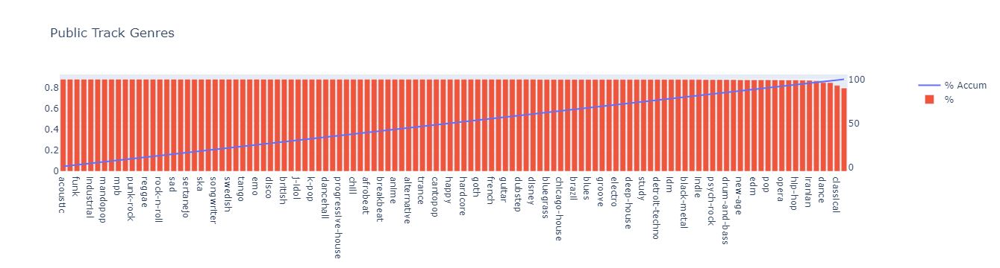

total_elements=114, top_elements=91


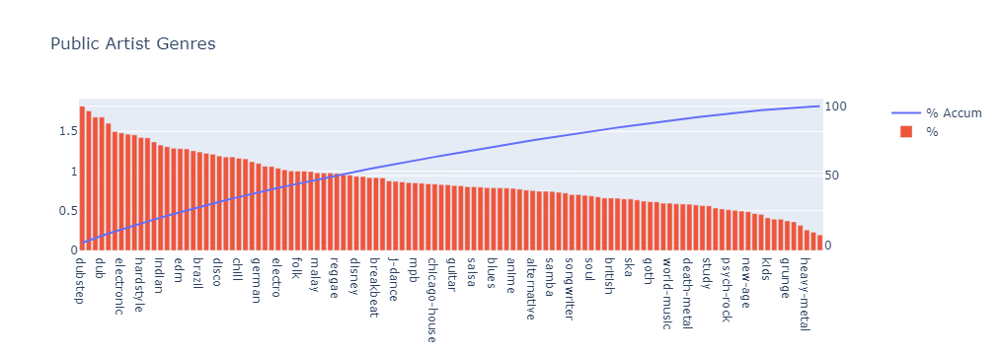

In [284]:
# px.bar(genre_info_public.sort_values(by="artists", ascending=False), x="track_genre", y="artists")
for element in ("track", "artist"):
    genre_info_plot = genre_info_public.sort_values(by=f"{element}_perc", ascending=False)
    genre_info_plot[f"{element}_perc_accum"] = genre_info_plot[f"{element}_perc"].cumsum()
    
    total_elements = genre_info_plot["track_genre"].nunique()
    top_elements = genre_info_plot.loc[genre_info_plot[f"{element}_perc_accum"] <= 90, "track_genre"].nunique()
    
    print(f"{total_elements=}, {top_elements=}")

    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(
        go.Scatter(x=genre_info_plot["track_genre"], y=genre_info_plot[f"{element}_perc_accum"], name="% Accum"),
        secondary_y=True,
    )
    fig.add_trace(
        go.Bar(x=genre_info_plot["track_genre"], y=genre_info_plot[f"{element}_perc"], name="%"),
        secondary_y=False,
    )
    fig.update_layout(
        title_text=f"Public {element.capitalize()} Genres"
    )

    fig.show()

In [395]:
genre_info_sorted = genre_info.sort_values(by=f"track_perc", ascending=False)
genre_info_sorted[f"track_perc_accum"] = genre_info_sorted[f"track_perc"].cumsum()

limit = 100

genre_info_sorted = genre_info_sorted.loc[genre_info_sorted[f"track_perc_accum"] <= limit, "genres"].unique()
genres =  genre_info_sorted.tolist()

model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

embeddings = model.encode(genres)

param_grid = {
    "n_clusters": range(3, 15)
}
grid_search = GridSearchCV(
    KMeans(random_state=random_state), param_grid=param_grid
)
grid_search.fit(embeddings)

df = pd.DataFrame(grid_search.cv_results_)
num_clusters = df.loc[df["rank_test_score"] == 1, "param_n_clusters"].values[0]

print(f"Recommended number of clusters is {clusters}")

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



Recommended number of clusters is 13


Cluster 0: rock, alternative rock, progressive rock, art rock, hard rock, classic rock, album rock, symphonic rock, modern rock, instrumental rock, psychedelic rock, garage rock, soft rock, classic canadian rock, stoner rock, indie rock, glam rock, rap rock, acid rock, post-rock, industrial rock, roots rock, folk rock, electronic rock, modern progressive rock, mexican classic rock, piano rock, noise rock, experimental rock, american post-rock, instrumental post-rock, boston rock, country rock, slacker rock, italian progressive rock, flute rock, experimental indie rock, scottish rock, modern alternative rock, taiwan post-rock, space rock, rock drums, comedy rock, acoustic rock, german hard rock, german rock, german stoner rock, modern hard rock, instrumental stoner rock, greek psychedelic rock
Cluster 1: electronica, industrial, laboratorio
Cluster 2: alternative metal, progressive metal, nu metal, metal, french metal, french death metal, thrash metal, rap metal, speed metal, swedish me

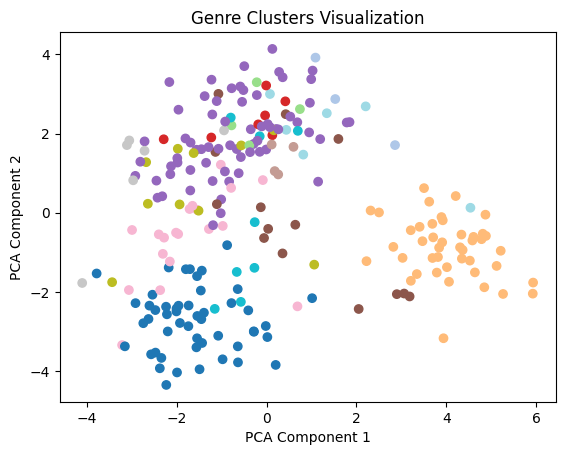

In [399]:
kmeans = KMeans(n_clusters=num_clusters, random_state=random_state)
kmeans.fit(embeddings)
labels = kmeans.labels_

# Print the genres grouped by cluster
clusters = {}
for genre, label in zip(genres, labels):
    if label not in clusters:
        clusters[label] = []
    clusters[label].append(genre)

clusters = dict(sorted(clusters.items()))

for cluster_id, genre_list in clusters.items():
    print(f"Cluster {cluster_id}: {', '.join(genre_list)}\n")

pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(embeddings)
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=labels, cmap='tab20')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('Genre Clusters Visualization')
plt.show()

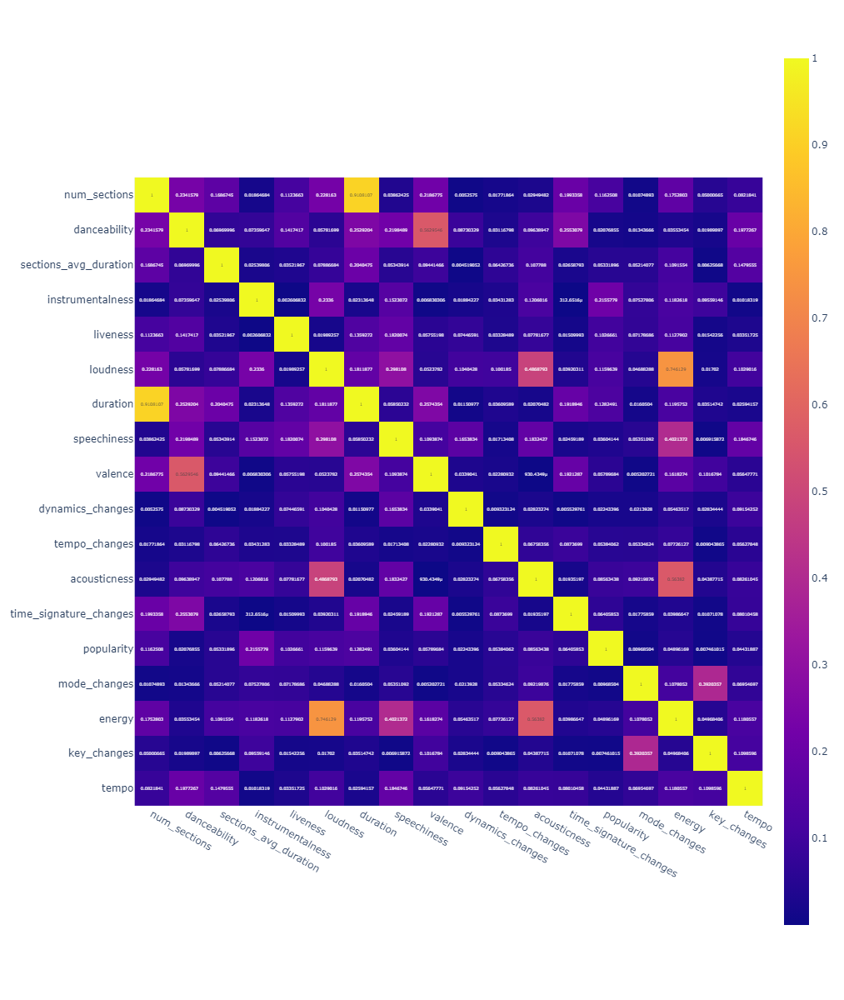

In [331]:
correlations = track_info[numerical_cols].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

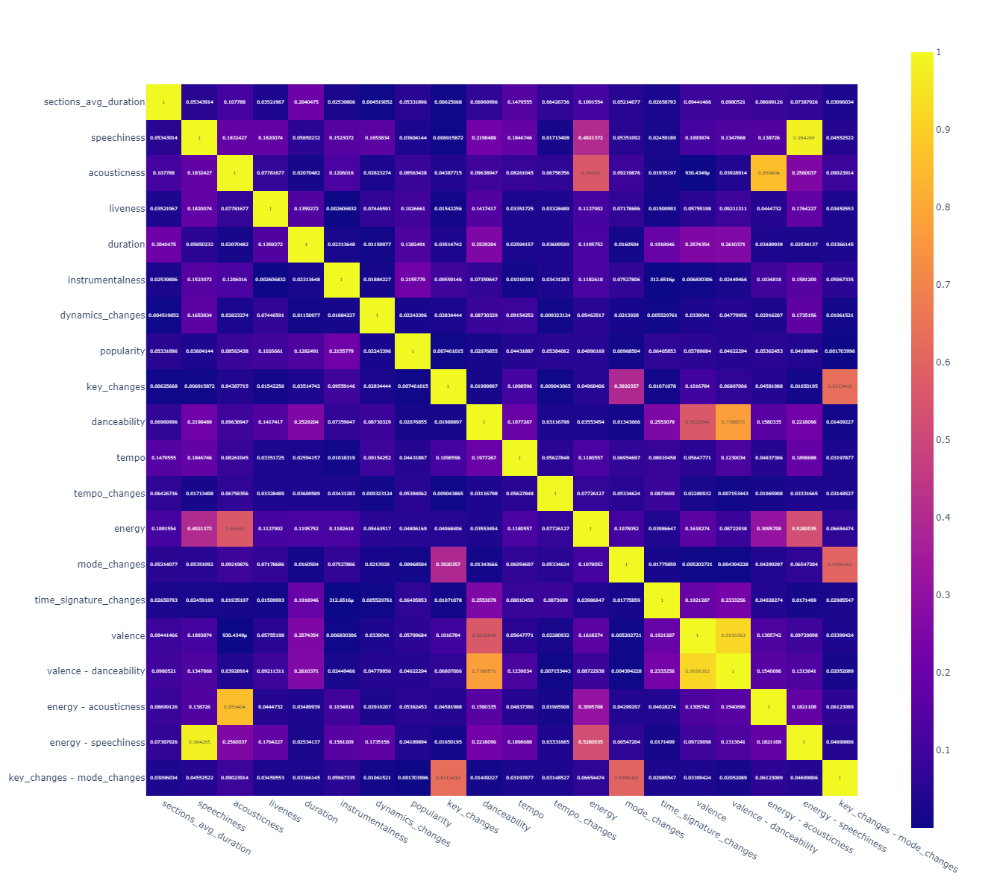

In [347]:
track_info_new_features = track_info.copy()

useless_cols = ["num_sections", "loudness"] 
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))

track_info_new_features = track_info_new_features[track_info_new_features.columns.difference(useless_cols)]

for pair in (("valence", "danceability"), ("energy", "acousticness"), ("energy", "speechiness"), ("key_changes", "mode_changes")):
    track_info_new_features[f"{pair[0]} - {pair[1]}"] = track_info_new_features[pair[0]] * track_info_new_features[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")

correlations = track_info_new_features[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

<Axes: xlabel='key_changes', ylabel='mode_changes'>

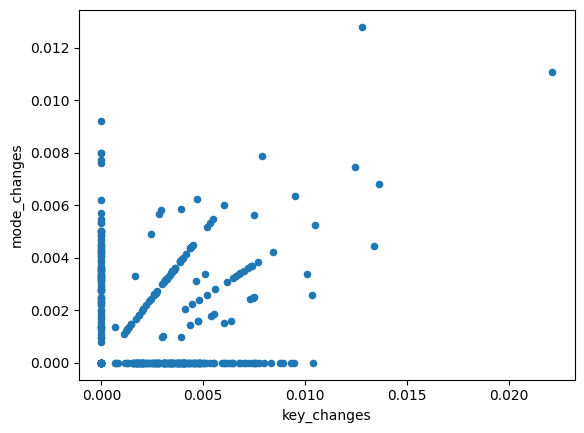

In [341]:
track_info.loc[:, ["mode_changes", "key_changes"]].plot(kind="scatter", y="mode_changes", x="key_changes")

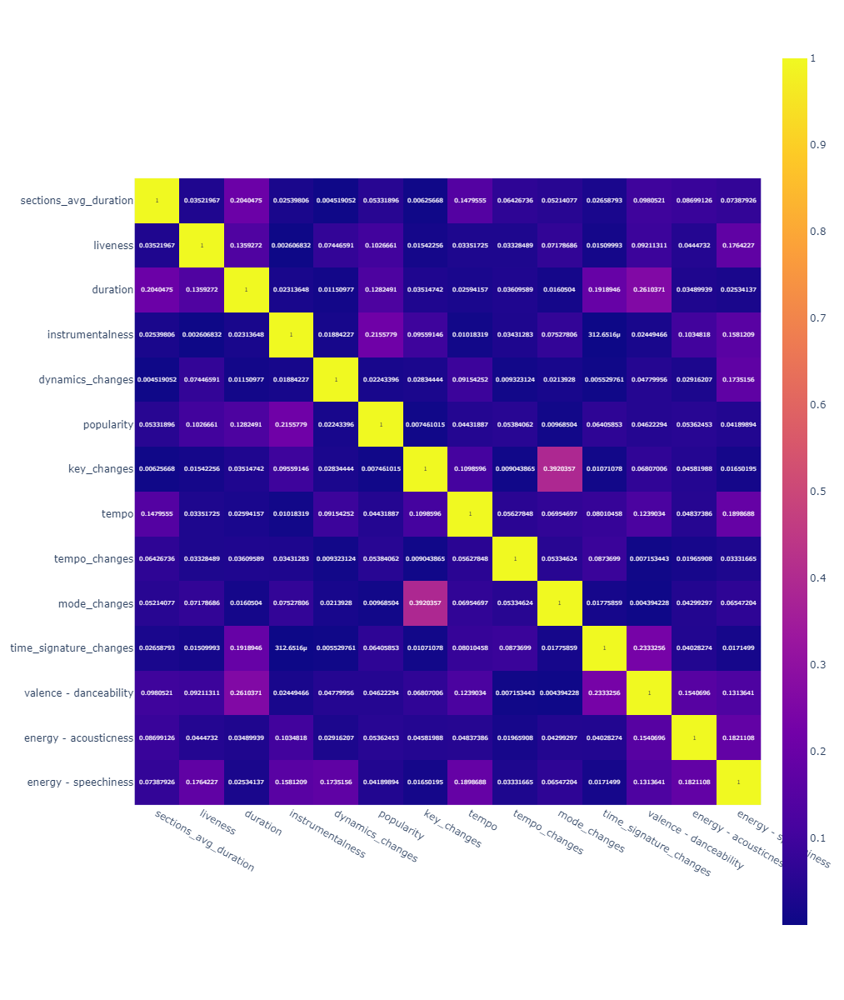

In [346]:
useless_cols = ["num_sections", "loudness", "energy", "acousticness", "valence", "danceability", "speechiness"] 
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))
numerical_cols_extra = numerical_cols_extra + ["valence - danceability", "energy - acousticness", "energy - speechiness"]

track_info_new_features = track_info_new_features[track_info_new_features.columns.difference(useless_cols)]

correlations = track_info_new_features[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

In [345]:
# track_info_alt = track_info.copy()

# useless_cols = ["num_sections", "loudness", "speechiness", "acousticness", "danceability"] #speechiness, acousticness, danceability
# _numerical_cols = list(set(numerical_cols).difference(useless_cols))

# track_info_alt = track_info_alt[track_info_alt.columns.difference(useless_cols)]
# track_info_alt["comb"]

# # for pair in (("valence", "danceability"), ("key_changes", "mode_changes")):
# #     track_info_alt[f"{pair[0]} - {pair[1]}"] = track_info_alt[pair[0]] * track_info_alt[pair[1]]
# #     _numerical_cols.append(f"{pair[0]} - {pair[1]}")

# correlations = track_info_alt[_numerical_cols].corr().abs()

# fig = px.imshow(correlations, text_auto=True)
# fig.update_layout(width=1300, height=1200, autosize=False)

# fig.show()

In [436]:
# one-hot encode categorical_cols 
# use numerical_cols + categorical_cols
# standarize all cols(non_standard_cols??)

track_info_new_features = track_info.copy()
useless_cols = ["num_sections", "loudness", "energy", "acousticness", "valence", "danceability", "speechiness"] 
combinations_cols = [("valence", "danceability"), ("energy", "acousticness"), ("energy", "speechiness")]
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))

for pair in combinations_cols:
    track_info_new_features[f"{pair[0]} - {pair[1]}"] = track_info_new_features[pair[0]] * track_info_new_features[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")
    
numerical_cols_extra = numerical_cols_extra + categorical_cols + [f"{pair[0]} - {pair[1]}" for pair in combinations_cols]

X = track_info_new_features[numerical_cols_extra]
X = pd.get_dummies(X, columns=categorical_cols)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# try pca, delete features with corr


In [437]:
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV


def gmm_bic_score(estimator, X):
    """Callable to pass to GridSearchCV that will use the BIC score."""
    # Make it negative since GridSearchCV expects a score to maximize
    return -estimator.bic(X)


param_grid = {
    "n_components": range(3, 20),
    "covariance_type": ["spherical", "tied", "diag", "full"],
}
grid_search = GridSearchCV(
    GaussianMixture(random_state=random_state), param_grid=param_grid, scoring=gmm_bic_score, 
)
grid_search.fit(X_scaled)

df = pd.DataFrame(grid_search.cv_results_)[
    ["param_n_components", "param_covariance_type", "mean_test_score"]
]
df["mean_test_score"] = -df["mean_test_score"]
df = df.rename(
    columns={
        "param_n_components": "Number of components",
        "param_covariance_type": "Type of covariance",
        "mean_test_score": "BIC score",
    }
)
df.sort_values(by="BIC score").head(10)

,Number of components,Type of covariance,BIC score
32,18,tied,-18541.958274
30,16,tied,-18357.697269
31,17,tied,-18205.922779
29,15,tied,-18129.410464
28,14,tied,-17297.463939
26,12,tied,-15602.613206
27,13,tied,-15415.122452
25,11,tied,-14199.391585
24,10,tied,-12331.407627
23,9,tied,-10927.807230


In [469]:
lower_limit = 0.1
gmm_components = 15

model = GaussianMixture(covariance_type="tied", n_components=gmm_components, random_state=random_state)
model.fit(X_scaled)
results = model.predict(X_scaled)
probabilities = model.predict_proba(X_scaled)

track_clustered = track_info.copy()
track_clustered["cluster_single"] = results
track_clustered["clusters"] = probabilities.tolist()
track_clustered["clusters"] = track_clustered["clusters"].apply(lambda x: [i for i, e in enumerate(x) if e > lower_limit])

track_clustered.head(5)

,num_sections,danceability,track_name,sections_avg_duration,instrumentalness,liveness,loudness,duration,speechiness,artist,...,energy,artist_id,key_changes,key,tempo,genres,explicit,case,cluster_single,clusters
0,7.0,0.677,No You Girls,31.970,0.000077,0.0967,-4.102,223.79,0.0296,Franz Ferdinand,...,0.916,0XNa1vTidXlvJ2gHSsRi4A,0.000000,D,104.780,"[alternative rock, dance rock, indie rock, mod...",False,user,3,[3]
1,14.0,0.449,Cliffs Of Dover - Instrumental,17.841,0.149000,0.2480,-12.029,249.77,0.0405,Eric Johnson,...,0.775,4CxobvwTpmfpIEbkYh4pAb,0.008007,G,94.907,"[instrumental bluegrass, instrumental rock, pr...",False,user,14,[14]
2,9.0,0.526,Genesis Ch.1. V.32,23.241,0.984000,0.1100,-9.747,209.17,0.0372,The Alan Parsons Project,...,0.582,2m62cc253Xvd9qYQ8d2X3d,0.000000,D,126.610,"[album rock, art rock, classic rock, mellow go...",False,user,3,[3]
3,13.0,0.745,Stop Don't Panic,20.936,0.588000,0.1880,-5.549,272.17,0.0502,Jamiroquai,...,0.911,6J7biCazzYhU3gM9j1wfid,0.000000,C#,112.450,[dance pop],False,user,10,[10]
4,27.0,0.270,America - 2003 Remaster,23.392,0.283000,0.3010,-8.755,631.57,0.0630,Yes,...,0.704,7AC976RDJzL2asmZuz7qil,0.004750,D,176.030,"[album rock, art rock, classic rock, hard rock...",False,user,3,[3]


In [442]:
# plot genre_info with cluster
genre_info_clustered = track_clustered.explode("genres")
genre_info_clustered["genres"] = genre_info_clustered["genres"].fillna("No Genre")

cluster_items = genre_info_clustered[["cluster_single", "genres"]].groupby("cluster_single").agg(list).reset_index()
cluster_items["genres"] = cluster_items["genres"].apply(lambda x: list(set(x)))

for _, row in cluster_items.iterrows():
    print(f"Cluster {row['cluster_single']}: {', '.join(row['genres'])}\n")

Cluster 0: progressive metal, symphonic rock, british invasion, math rock, dance pop, rock drums, video game music, swedish progressive metal, contemporary jazz, opera metal, post-hardcore, rap metal, grunge, dance-punk, chamber pop, roots rock, acid rock, funk rock, classic rock, political hip hop, canadian metal, old school thrash, british math rock, melancholia, french metal, rock, trip hop, merseybeat, australian psych, djent, sacramento indie, emo, uk post-punk, jazz funk, alternative rock, modern rock, progressive rock, dark pop, birmingham metal, post-grunge, art rock, album rock, electric bass, contemporary post-bop, soft rock, garage rock, instrumental rock, oxford indie, conscious hip hop, hard rock, jam band, rap rock, alternative metal, swedish doom metal, new wave, permanent wave, stoner rock, modern progressive rock, microtonal, classic canadian rock, funk metal, progressive jazz fusion, neo-psychedelic, jazz fusion, jazz, nu metal, uk doom metal, breakcore, soul, electro

In [472]:
genre_info_clustered = track_clustered.explode("genres")
genre_info_clustered["genres"] = genre_info_clustered["genres"].fillna("No Genre")
genre_info_clustered = genre_info_clustered.explode("clusters")

cluster_items = genre_info_clustered[["clusters", "genres"]].groupby("clusters").agg(list).reset_index()
cluster_items["genres"] = cluster_items["genres"].apply(lambda x: list(set(x)))

for _, row in cluster_items.iterrows():
    print(f"Cluster {row['clusters']}: {', '.join(row['genres'])}\n")

Cluster 0: progressive metal, symphonic rock, british invasion, math rock, dance pop, rock drums, video game music, swedish progressive metal, contemporary jazz, opera metal, post-hardcore, rap metal, grunge, dance-punk, chamber pop, roots rock, acid rock, funk rock, classic rock, political hip hop, canadian metal, old school thrash, british math rock, melancholia, french metal, rock, trip hop, merseybeat, australian psych, djent, sacramento indie, emo, uk post-punk, jazz funk, alternative rock, modern rock, progressive rock, dark pop, birmingham metal, post-grunge, art rock, album rock, electric bass, contemporary post-bop, soft rock, garage rock, instrumental rock, oxford indie, conscious hip hop, hard rock, jam band, rap rock, alternative metal, swedish doom metal, new wave, permanent wave, stoner rock, modern progressive rock, microtonal, classic canadian rock, funk metal, progressive jazz fusion, neo-psychedelic, jazz fusion, jazz, nu metal, uk doom metal, breakcore, soul, electro

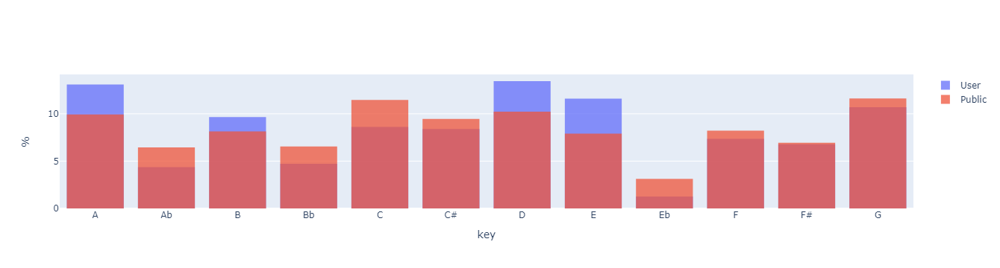

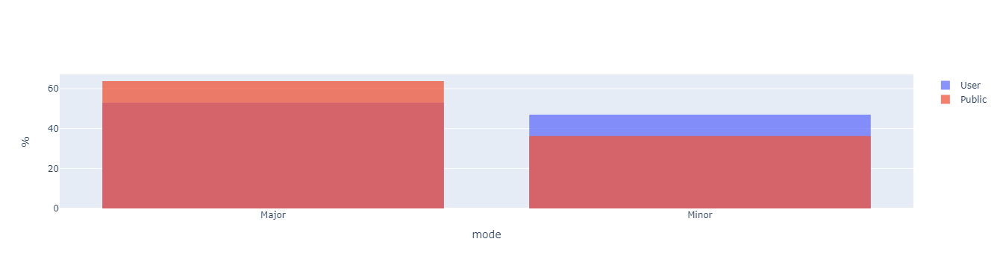

In [214]:
for col in categorical_cols:
    df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
    df = df.sort_values(by=col)
    
    fig = go.Figure()
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User"))
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public"))

    fig.update_layout(
        barmode="overlay",
        xaxis_title_text=col,
        yaxis_title_text='%'
    )
    fig.update_traces(opacity=0.75)
    fig.show()

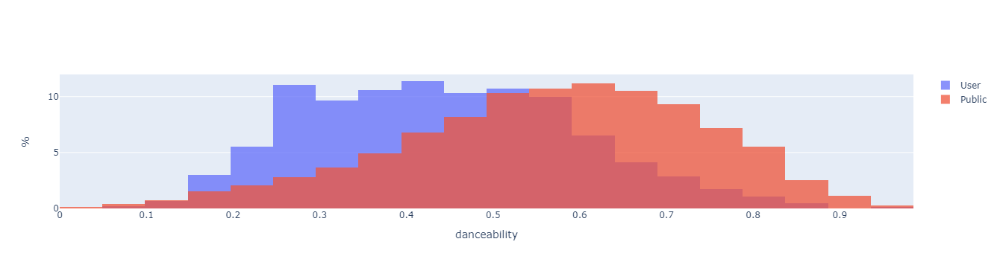

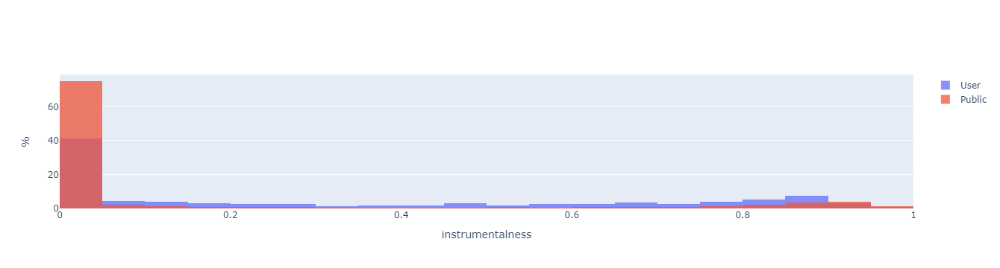

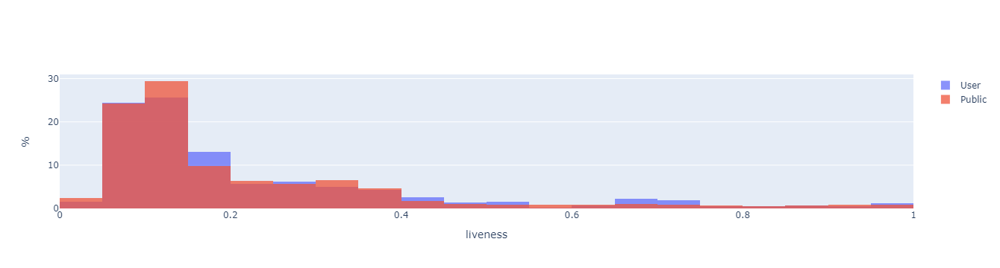

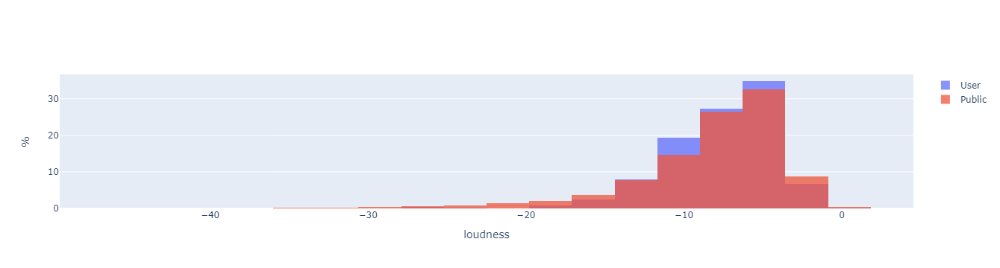

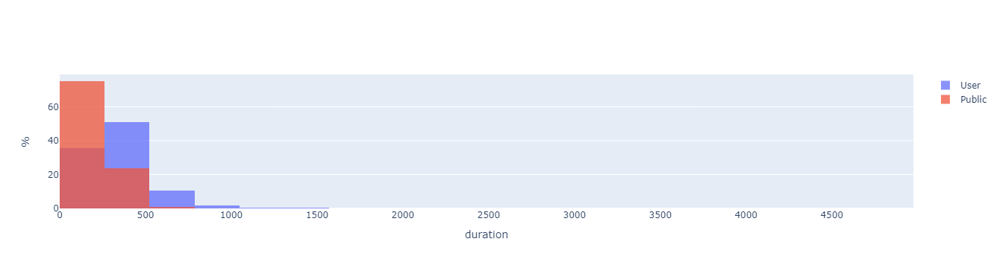

...

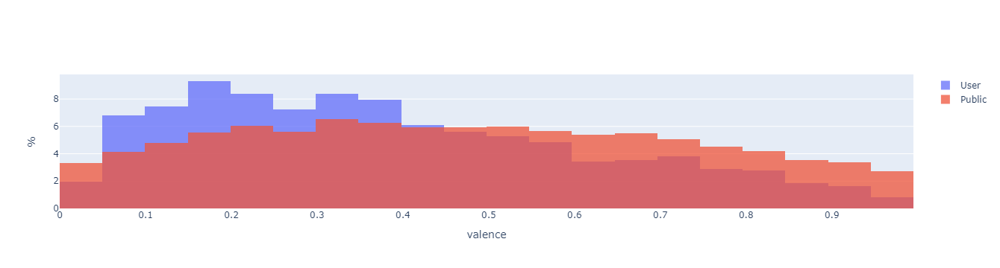

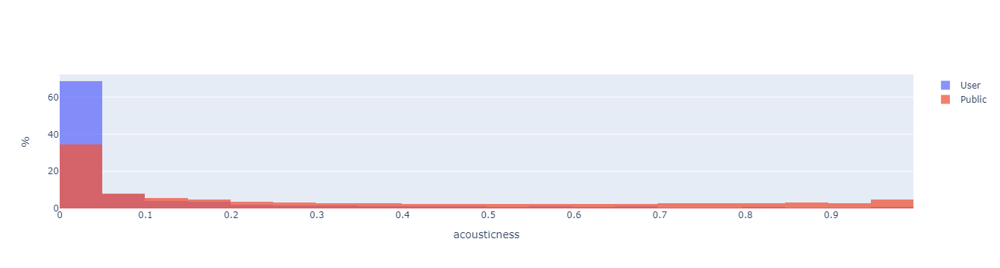

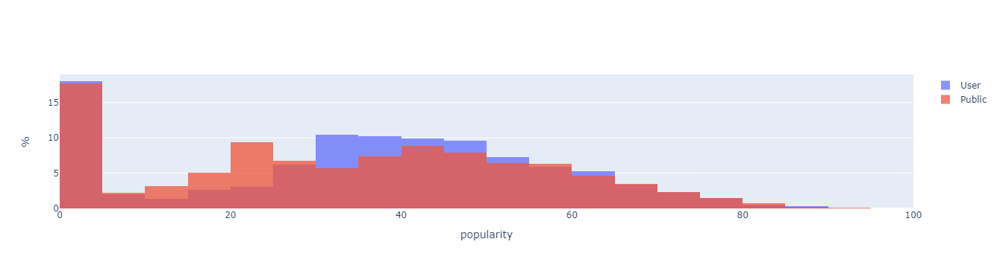

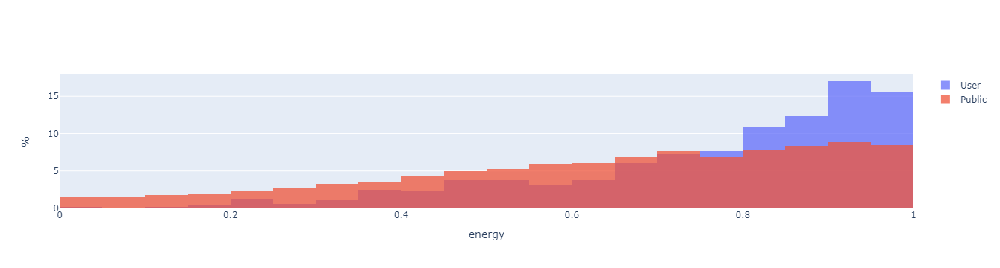

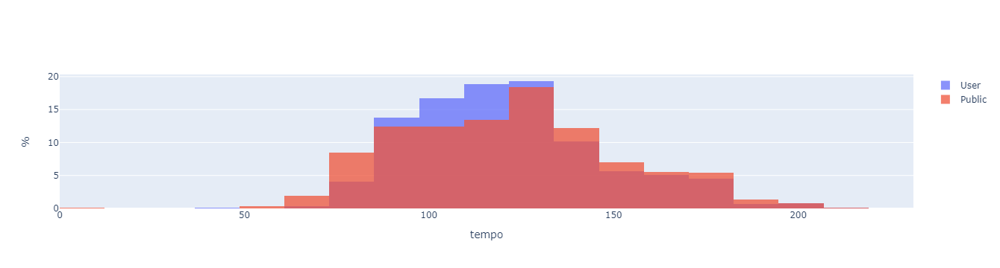

In [156]:
for col in numerical_cols:
    if col in track_info.columns and col in public_data.columns:
        df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
        fig = go.Figure()

        bin_start = df[col].min()
        bin_end = df[col].max()
        bin_size = abs(bin_end - bin_start) / 20

        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User", autobinx=False, xbins=dict( 
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))
        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public", autobinx=False, xbins=dict(
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))

        fig.update_layout(
            barmode="overlay",
            xaxis_title_text=col,
            yaxis_title_text='%'
        )
        fig.update_traces(opacity=0.75)
        fig.show()

In [ ]:
# train model with public data, test with user

In [ ]:
# regression only with user data

# try multi output or as is

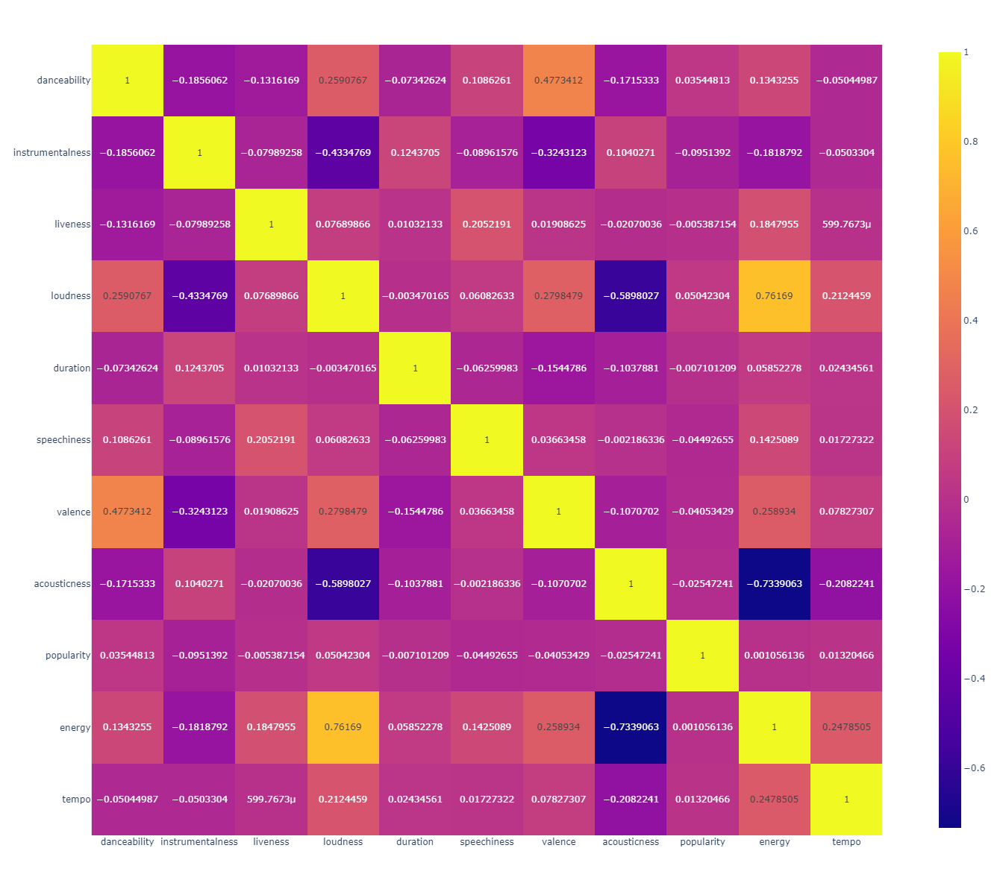

In [217]:
correlations_public = public_data[numerical_cols_public].corr()

fig = px.imshow(correlations_public, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

In [ ]:
# save

In [76]:
import chart_studio


chart_studio.tools.set_credentials_file(username='jcf94', api_key='Ma8Fg56h3ANUjoPRemcK')

In [77]:
import chart_studio.plotly as py

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)
py.plot(fig, filename = 'test-plot', auto_open=True)

'https://plotly.com/~jcf94/1/'

In [ ]:
# save results to csv
# save html with numerical and plotly plots 

top_artists.to_csv("top_artists.csv")
recently_played.to_csv("recently_played.csv")